In [1]:
import numpy as np
from scipy.optimize import fsolve
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import display, clear_output, Audio
%matplotlib inline
# %matplotlib widget
plt.rcParams['figure.dpi']= 150

In [2]:
# Transport parameters
s_perm = 1.2
u_perm_val = 1.2
w_D_perm = 10
w_C_perm = 10
S_input = 0.8
U_input = 2
osm_input = 2
u_frac = 1
s_dump = 0.04
# s_dump = 0.0285
a_D = 0.25
a_C = 0.25
a_A = 0.25
a_0 = 0.25

# discretization
N = 50
dx = 1/N
dt = 0.5

u_perm = np.zeros(N)
for l in range(N):
    perm_grids = u_frac*N
    insul = np.floor(N-perm_grids)
    if l==insul:
        u_perm[l] = u_perm_val*(perm_grids - np.ceil(perm_grids-1))
    elif l>insul:
        u_perm[l] = u_perm_val

def diff_x(y): 
    n = len(y)-1
    diff = np.zeros(n)
    for l in range(n):
        diff[l] = (y[l+1]-y[l])/dx
    
    return diff

def avg(y):
    n = len(y)-1
    average = np.zeros(n)
    for l in range(n):
        average[l] = (y[l+1]+y[l])/2
    
    return average

In [3]:
y_init = np.zeros(8*N+7)
q_D_init = y_init[:N+1]
q_C_init = y_init[(N+1):2*(N+1)]
q_0_init = y_init[2*(N+1):3*(N+1)]
s_D_init = y_init[3*(N+1):4*(N+1)]
s_A_init = y_init[4*(N+1):5*(N+1)]
u_C_init = y_init[5*(N+1):6*(N+1)]
s_0_init = y_init[6*(N+1):7*N+6]
u_0_init = y_init[7*N+6:8*N+6]
q_A_init = y_init[8*N+6:]

# ss = np.load('./4fluxes_1nephron_max.npy')
ss = np.load('./unstable.npy')
q_D_init[:] = ss[2*(N+1):3*(N+1)]
q_A_init[:] = -q_D_init[-1]
q_C_init[:] = ss[3*(N+1):4*(N+1)]
q_0_init[:] = q_C_init[-1] - q_C_init - q_A_init - q_D_init
s_D_init[:] = S_input/q_D_init
s_A_init[:] = ss[:(N+1)]/q_A_init
s_0_init[:] = (ss[N] - avg(ss[:(N+1)]))/avg(q_0_init)
u_C_init[:] = ss[(N+1):2*(N+1)]/q_C_init
u_0_init[:] = (ss[2*N+1] - avg(ss[(N+1):2*(N+1)]))/avg(q_0_init)

In [5]:
# def res_flows(q,w_C,w_D):
#     q_D = q[:N+1]
#     q_C = q[(N+1):2*(N+1)]
#     q_0 = q[2*(N+1):3*(N+1)]

#     q_A = -q_D[-1]

#     residue = np.zeros(3*(N+1))
#     res_D = residue[:N+1]
#     res_C = residue[(N+1):2*(N+1)]
#     res_0 = residue[2*(N+1):3*(N+1)]

#     res_D[0] = q_D[0] - 2*S_input/osm_input
#     res_D[1:] = diff_x(q_D) + w_D
#     res_C[0] = q_C[0] - U_input/osm_input
#     res_C[1:] = diff_x(q_C) + w_C
#     res_0[:] = q_C[-1] - q_C - q_A - q_D

#     return residue


def fw_euler(y_0):
    q_D_0 = y_0[:N+1]
    q_C_0 = y_0[(N+1):2*(N+1)]
    q_0_0 = y_0[2*(N+1):3*(N+1)]
    s_D_0 = y_0[3*(N+1):4*(N+1)]
    s_A_0 = y_0[4*(N+1):5*(N+1)]
    u_C_0 = y_0[5*(N+1):6*(N+1)]
    s_0_0 = y_0[6*(N+1):7*N+6]
    u_0_0 = y_0[7*N+6:8*N+6]
    q_A_0 = y_0[8*N+6:]

    y = y_0.copy()
    q_D = y[:N+1]
    q_C = y[(N+1):2*(N+1)]
    q_0 = y[2*(N+1):3*(N+1)]
    s_D = y[3*(N+1):4*(N+1)]
    s_A = y[4*(N+1):5*(N+1)]
    u_C = y[5*(N+1):6*(N+1)]
    s_0 = y[6*(N+1):7*N+6]
    u_0 = y[7*N+6:8*N+6]
    q_A = y[8*N+6:]

    S_D_0 = s_D_0*q_D_0
    s_D[1:] = s_D_0[1:] + dt*(-diff_x(S_D_0))/a_D

    S_A_0 = s_A_0*q_A_0
    j_s = s_perm*(avg(s_A_0) - s_0_0)
    s_A[-1] = s_D[-1]
    s_A[:-1] = s_A_0[:-1] + dt*(
        -diff_x(S_A_0) -j_s
    )/a_A

    S_0_0 = s_0_0*avg(q_0_0)
    div_S_0 = np.zeros(N)
    div_S_0[-1] = 2*( - S_0_0[-1])/dx
    div_S_0[:-1] = diff_x(S_0_0)
    s_0[:] = s_0_0 + dt*(
        -div_S_0 +j_s + s_dump
    )/a_0

    U_C_0 = u_C_0*q_C_0
    j_u = u_perm*(avg(u_C_0) - u_0_0)
    u_C[1:] = u_C_0[1:] + dt*(
        -diff_x(U_C_0) - j_u
    )/a_C

    U_0_0 = u_0_0*avg(q_0_0)
    div_U_0 = np.zeros(N)
    div_U_0[-1] = 2*( - U_0_0[-1])/dx
    div_U_0[:-1] = diff_x(U_0_0)
    u_0[:] = u_0_0 + dt*(
        - div_U_0 + j_u
    )/a_0

    q_D[0] = 2*S_input/osm_input
    q_C[0] = U_input/osm_input
    w_C = w_C_perm*(2*s_0+u_0-avg(u_C))
    w_D = w_D_perm*(2*s_0+u_0-2*avg(s_D))
    q_0[-1] = 0
    for k in range(N):
        q_D[k+1] = q_D[k] + dx*(-w_D[k])
        q_C[k+1] = q_C[k] + dx*(-w_C[k])
        # q_0[N-k-1] = q_0[N-k]+dx*(-w_C[N-k-1]-w_D[N-k-1])
    q_A[:] = -q_D[-1]
    q_0[:] = q_C[-1] - q_C - q_A - q_D
    # y[:3*(N+1)] = fsolve(res_flows,y[:3*(N+1)],args=(w_C,w_D))
    
    return y

In [138]:
# Transport parameters
s_perm = 1.2
u_perm_val = 1.2
w_D_perm = 10
w_C_perm = 10
S_input = 0.8
U_input = 2
osm_input = 2
u_frac = 1
s_dump = 0.0505
# s_dump = 0.0285
a_D = 0.25
a_C = 0.25
a_A = 0.25
a_0 = 0.25

# discretization
N = 50
dx = 1/N
steps = 20000
# steps = 1000
# dt = 0.0025
# dt = 0.0005
dt = 0.0025

# y = y_init.copy()
# y = np.load('./conv_to_third_ss.npy')[:16001]
# y = y[-1]
# y = y_ghost[0]
y = y0505[-1]

for n in range(steps):
    y = np.vstack((y,np.zeros(8*N+7)))
    y[-1,:] = fw_euler(y[-2,:])

q_D = y[:,:N+1]
q_C = y[:,(N+1):2*(N+1)]
q_0 = y[:,2*(N+1):3*(N+1)]
s_D = y[:,3*(N+1):4*(N+1)]
s_A = y[:,4*(N+1):5*(N+1)]
u_C = y[:,5*(N+1):6*(N+1)]
s_0 = y[:,6*(N+1):7*N+6]
u_0 = y[:,7*N+6:8*N+6]
q_A = y[:,8*N+6:]

osm_D = 2*s_D[-1,:]
osm_A = 2*s_A[-1,:]
osm_C = u_C[-1,:]
osm_0 = 2*s_0[-1,:]+u_0[-1,:]

from winsound import Beep
Beep(300, 200)
Beep(300, 200)
Beep(300, 200)

C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/1930589447.py:44: RuntimeWarning: overflow encountered in multiply
  S_D_0 = s_D_0*q_D_0
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/3753829459.py:35: RuntimeWarning: invalid value encountered in double_scalars
  diff[l] = (y[l+1]-y[l])/dx
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/1930589447.py:54: RuntimeWarning: overflow encountered in multiply
  S_0_0 = s_0_0*avg(q_0_0)
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/1930589447.py:62: RuntimeWarning: overflow encountered in multiply
  U_C_0 = u_C_0*q_C_0
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/1930589447.py:68: RuntimeWarning: overflow encountered in multiply
  U_0_0 = u_0_0*avg(q_0_0)
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/3753829459.py:43: RuntimeWarning: invalid value encountered in double_scalars
  average[l] = (y[l+1]+y[l])/2
C:\Users\馬予棟\AppData\Local\Temp/ipykernel_20440/1930589447.py:78: RuntimeWarning: invalid value encountered in subtract
  w_C = w_

In [139]:
y = np.vstack((y0505,y[1:19001]))
# y = y[:14401]

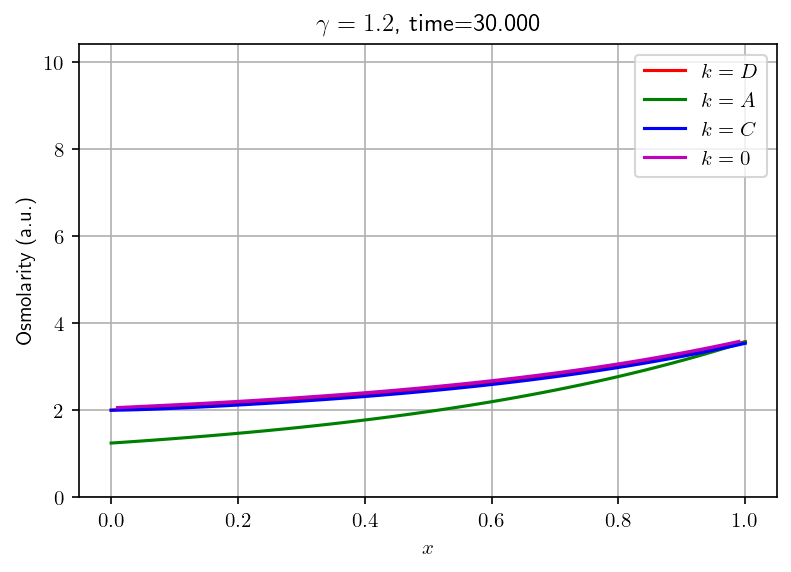

In [61]:
fig, ax = plt.subplots()
plt.rcParams['text.usetex'] = True
fig.set_facecolor('white')
ax.grid(True, which='both')
x = np.linspace(0,1,num=N+1)
x_avg = np.linspace(dx/2,1-dx/2,num=N)

q_D = y[:,:N+1]
q_C = y[:,(N+1):2*(N+1)]
q_0 = y[:,2*(N+1):3*(N+1)]
s_D = y[:,3*(N+1):4*(N+1)]
s_A = y[:,4*(N+1):5*(N+1)]
u_C = y[:,5*(N+1):6*(N+1)]
s_0 = y[:,6*(N+1):7*N+6]
u_0 = y[:,7*N+6:8*N+6]
q_A = y[:,8*N+6:]

osm_D = 2*s_D[:,:]
osm_A = 2*s_A[:,:]
osm_C = u_C[:,:]
osm_0 = 2*s_0[:,:]+u_0[:,:]

line1, = ax.plot(x, osm_D[-1,:], color = "r", label=r'$k=D$')
line2, = ax.plot(x, osm_A[-1,:], color = "g", label=r'$k=A$')
line3, = ax.plot(x, osm_C[-1,:], color = "b", label=r'$k=C$')
line4, = ax.plot(x_avg, osm_0[-1,:], color = "m", label=r'$k=0$')

def update(num, x, x_avg, y1, y2, y3, y4, line1, line2, line3, line4):
    line1.set_data(x, y1[300*num,:])
    line2.set_data(x, y2[300*num,:])
    line3.set_data(x, y3[300*num,:])
    line4.set_data(x_avg, y4[300*num,:])
    ax.set_title(r'$\gamma = 1.2$, time={0:.3f}'.format(300*num*0.0005))
    return [line1,line2,line3,line4]

ax.legend()
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'Osmolarity (a.u.)')
ax.set_ylim(0, np.amax(osm_0)+1)

# ani = animation.FuncAnimation(fig, update, frames=1601, fargs=[x_avg, osm_D, osm_A, osm_C, osm_0, line1, line2, line3, line4],
#                   interval=100, blit=True)

# plt.show()
# plt.rcParams["animation.html"] = "jshtml"
ani = animation.FuncAnimation(fig, update, frames=201, fargs=[x, x_avg, osm_D, osm_A, osm_C, osm_0, line1, line2, line3, line4],
                  interval=20, blit=True)
from IPython.display import HTML
# HTML(ani.to_html5_video())
display(HTML(ani.to_jshtml()))
Beep(300, 200)
Beep(300, 200)
Beep(300, 200)

In [62]:
# np.save('conv_to_third_ss_ver2.npy',y)
# np.save('blowup_c_dump.npy',y[:28501])
# np.save('third_to_first_ss_dump005.npy',y)
np.save('third_gone.npy',y)

Now, we examine stability when there are two steady states, then after the (presumably) saddle node bifurcation.

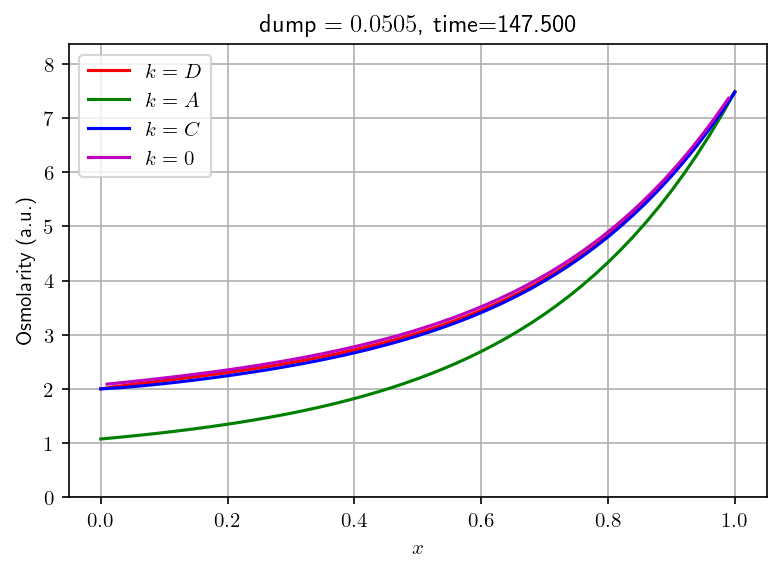

In [141]:
fig, ax = plt.subplots()
plt.rcParams['text.usetex'] = True
fig.set_facecolor('white')
ax.grid(True, which='both')
x = np.linspace(0,1,num=N+1)
x_avg = np.linspace(dx/2,1-dx/2,num=N)

q_D = y[:,:N+1]
q_C = y[:,(N+1):2*(N+1)]
q_0 = y[:,2*(N+1):3*(N+1)]
s_D = y[:,3*(N+1):4*(N+1)]
s_A = y[:,4*(N+1):5*(N+1)]
u_C = y[:,5*(N+1):6*(N+1)]
s_0 = y[:,6*(N+1):7*N+6]
u_0 = y[:,7*N+6:8*N+6]
q_A = y[:,8*N+6:]

osm_D = 2*s_D[:,:]
osm_A = 2*s_A[:,:]
osm_C = u_C[:,:]
osm_0 = 2*s_0[:,:]+u_0[:,:]

line1, = ax.plot(x, osm_D[-1,:], color = "r", label=r'$k=D$')
line2, = ax.plot(x, osm_A[-1,:], color = "g", label=r'$k=A$')
line3, = ax.plot(x, osm_C[-1,:], color = "b", label=r'$k=C$')
line4, = ax.plot(x_avg, osm_0[-1,:], color = "m", label=r'$k=0$')

def update(num, x, x_avg, y1, y2, y3, y4, line1, line2, line3, line4):
    line1.set_data(x, y1[200*num,:])
    line2.set_data(x, y2[200*num,:])
    line3.set_data(x, y3[200*num,:])
    line4.set_data(x_avg, y4[200*num,:])
    ax.set_title(r'dump $= 0.0505$, time={0:.3f}'.format(200*num*0.0025))
    return [line1,line2,line3,line4]

ax.legend()
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'Osmolarity (a.u.)')
ax.set_ylim(0, np.amax(osm_0)+1)

# ani = animation.FuncAnimation(fig, update, frames=1601, fargs=[x_avg, osm_D, osm_A, osm_C, osm_0, line1, line2, line3, line4],
#                   interval=100, blit=True)

# plt.show()
# plt.rcParams["animation.html"] = "jshtml"
ani = animation.FuncAnimation(fig, update, frames=296, fargs=[x, x_avg, osm_D, osm_A, osm_C, osm_0, line1, line2, line3, line4],
                  interval=40, blit=True)
from IPython.display import HTML
# HTML(ani.to_html5_video())
display(HTML(ani.to_jshtml()))
Beep(300, 200)
Beep(300, 200)
Beep(300, 200)

In [143]:
# y_ghost = y.copy()
# y05 = y.copy()
# y051 = y.copy()
# y0505 = y.copy()

# np.save('ghost05.npy',y05)
# np.save('ghost0505.npy',y)

In [135]:
(y[-1]-y[-2])@(y[-1]-y[-2])

3.218575739121358e-09